<a href="https://colab.research.google.com/github/BRIJNANDA1979/Segmenting-Kelp-Forests-/blob/main/Version_11_AWS_Another_copy_of_Version_1_4_data_Segmenting_Kelp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install earthpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 46.7 MB/s eta 0:00:00


In [ ]:
from glob import glob
import os
import numpy as np
import matplotlib.pyplot as plt
import rasterio
import rasterio as rio
from rasterio.plot import show
from rasterio.plot import plotting_extent
import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep
import earthpy.mask as em

In [ ]:
test_data_path = '/content/drive/MyDrive/test_satellite/'

In [ ]:
test_files = os.listdir(test_data_path)

In [ ]:
def masking(X, Band_binary):

  # masking the array1 by using array2
  # where array2 mod 7 is true
  mask = np.ma.masked_where(Band_binary,X)

  return mask

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
import pandas as pd

In [ ]:
################################333  Start modelling now.....

In [8]:
stop=1
Kelp_files_list=[]
files_with_zero_class = []
C_with_All_zeroes =[]
from matplotlib.colors import ListedColormap
for i in test_files:                           ###### Apply this on ALL FILES IN NEW MODEL
    with rasterio.open(test_data_path  + i) as src:
        #show(src,cmap='terrain')
        GREEN=src.read(4)    #### Only one out of 7 bands NOT labelled Data
        NIR = src.read(2)
        RED = src.read(3)
        SWIR = src.read(1)
        BLUE = src.read(5)
        CLOUD = src.read(6)

        mask_green = masking(GREEN,CLOUD)    ############3 masking all bands with Clouds
        mask_nir = masking(NIR,CLOUD)
        mask_red = masking(RED,CLOUD)
        mask_swir = masking(SWIR,CLOUD)
        mask_blue = masking(BLUE,CLOUD)

        NDVI   = (es.normalized_diff(mask_nir,mask_red))
        CVI = (es.normalized_diff(mask_nir,mask_green))
        #show(NDVI,cmap='Greens')

        # Create classes and apply to NDVI results
        ndvi_class_bins = [0.01,0.35]    ##### LESS VEGETATION FOR KELP
        ndvi_landsat_class = np.digitize(NDVI, ndvi_class_bins)      #### https://www.geeksforgeeks.org/python-numpy-np-digitize-method/

        # Apply the nodata mask to the newly classified NDVI data
        ndvi_landsat_class = np.ma.masked_where(
        np.ma.getmask(NDVI), ndvi_landsat_class)
        np.unique(ndvi_landsat_class)

        # Define color map
        nbr_colors = [ "y", "g"]
        nbr_cmap = ListedColormap(nbr_colors)

        # Define class names
        ndvi_cat_names = [

                    "Low Vegetation",

                    "High Vegetation",
                        ]

        # Get list of classes
        classes = np.unique(ndvi_landsat_class)
        classes = classes.tolist()
          # The mask returns a value of none in the classes. remove that
        classes = classes[0:2]
        if(len(classes) < 2):
          print("no kelp")
          files_with_zero_class.append(i)
          break


        # Plot your data
        fig, ax = plt.subplots(figsize=(6, 6))
        #im = ax.imshow(ndvi_landsat_class, cmap=nbr_cmap)

        #ep.draw_legend(im_ax=im, classes=classes, titles=ndvi_cat_names)
        #ax.set_title(
                     # "Landsat 8 - Filtered at 0.5 Normalized Difference Vegetation Index (NDVI) Classes",fontsize=14,)
        #ax.set_axis_off()

        # Auto adjust subplot to fit figure size
        #plt.tight_layout()
        #plt.show()


        MIR=1
        KT = (0.1509*mask_blue+ .1793*mask_green+0.3279* mask_red +0.3406*mask_nir+0.7112*MIR +0.4572*mask_swir)       #### For Water positive values mark water
        MNDWI= (es.normalized_diff(mask_green,mask_swir))    ### For Water
        NDWI = (es.normalized_diff(mask_red,mask_swir))    #### for Water

# Create classes and apply to MNDWI results
        mndwi_class_bins = [0.01,0.35]    #####ALL Water  FOR KELP
        mndwi_landsat_class = np.digitize(MNDWI, mndwi_class_bins)      #### https://www.geeksforgeeks.org/python-numpy-np-digitize-method/

        # Apply the nodata mask to the newly classified MNDWI data
        mndwi_landsat_class = np.ma.masked_where(
        np.ma.getmask(MNDWI), mndwi_landsat_class)
        np.unique(mndwi_landsat_class)

        # Define color map
        nbr_colors = [ "y", "b"]
        nbr_cmap = ListedColormap(nbr_colors)

        # Define class names
        mndwi_cat_names = [

                    "Less Water",

                    "More Water",
                        ]

        # Get list of classes
        classes = np.unique(mndwi_landsat_class)
        classes = classes.tolist()
          # The mask returns a value of none in the classes. remove that
        classes = classes[0:2]
        if(len(classes) < 2):
          print("no kelp")
          files_with_zero_class.append(i)
          break

        # Plot your data
        fig, ax = plt.subplots(figsize=(6, 6))
        #im = ax.imshow(mndwi_landsat_class, cmap=nbr_cmap)

        #ep.draw_legend(im_ax=im, classes=classes, titles=mndwi_cat_names)
        #ax.set_title(
                      "Landsat 8 - Filtered at 0.45 MNDWI Classes",fontsize=14,)
        #ax.set_axis_off()

        # Auto adjust subplot to fit figure size
        #plt.tight_layout()
        #plt.show()

        A = (mndwi_landsat_class)   #### More water
        B = (ndvi_landsat_class)      ##### less vegetation

        A = masking(A,CLOUD)  ### making sure Cloud mask is applied to output kelp
        B=masking(B,CLOUD)

        C = np.logical_and(A, B)

              ######     this C is kelp


        ##### MASK C with cloud....!!!!
        #C_mask = masking(C,CLOUD)
        #show(C,cmap='Greens')

        if C.all == False:
          print("not kelp")
          C_with_All_zeroes.append(C)



        else:
          x = 1 *C
          x[x!=0]=1
          #x.mask = False   #### remove mask values inherited from C after masking
          import numpy.ma as ma
          X = ma.getdata(x)
          #Y = ma.getmaskarray(x)

          array = X

          #show(array,cmap='Greens')
          #print("kelp")


          # Write an array as a raster band to a new 8-bit file. For
          # the new file's profile, we start with the profile of the source
          # context manager.
          with rasterio.Env():

    # Write an array as a raster band to a new 8-bit file. For
    # the new file's profile, we start with the profile of the source
            profile = src.profile

    # And then change the band count to 1, set the
    # dtype to uint8, and specify LZW compression.
            profile.update(
            dtype=rasterio.uint8,
            count=1,
            compress='lzw')

            with rasterio.open('/content/drive/MyDrive/3/'+i, 'w', **profile) as dst:
              dst.write(array.astype(rasterio.uint8), 1)
          Kelp_files_list.append(i)

IndentationError: unexpected indent (<ipython-input-8-571eb43cd982>, line 64)

In [ ]:
len(Kelp_files_list)

1426

In [ ]:
C_with_All_zeroes


[]

In [ ]:
files_with_zero_class

[]

In [ ]:
submit_list = os.listdir('/content/drive/MyDrive/3')

In [ ]:
len(submit_list)

1426

In [ ]:
submit_list[0:2]

['HP480632_kelp.tif', 'HP504630_kelp.tif']

In [ ]:
for i in submit_list:
  s=i.split('_')
  ss = s[0] + '_kelp.tif'
  os.rename('/content/drive/MyDrive/3/'+i,'/content/drive/MyDrive/3/'+ss)

In [ ]:
import os
predicted = os.listdir('/content/drive/MyDrive/3')

In [ ]:
len(predicted)

1426

In [ ]:
total = os.listdir('/content/drive/MyDrive/test_satellite')


In [ ]:
len(total)

1426

In [ ]:
not_predicted = []
for i in total:
  s=i.split('_')
  ss = s[0] + '_kelp.tif'
  if ss not in predicted:
    not_predicted.append(ss)

In [ ]:
len(not_predicted)

0

In [ ]:
not_predicted[0:2]

[]



Improve on model

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:314: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  dataset = writer(
/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:314: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flippe

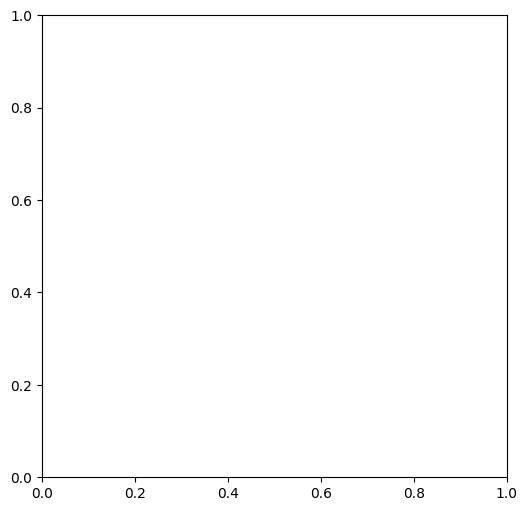

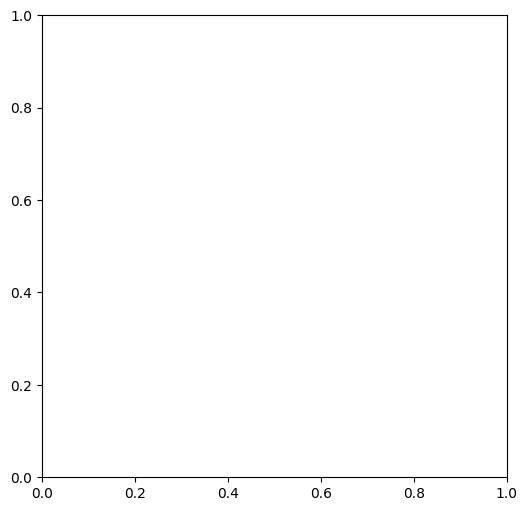

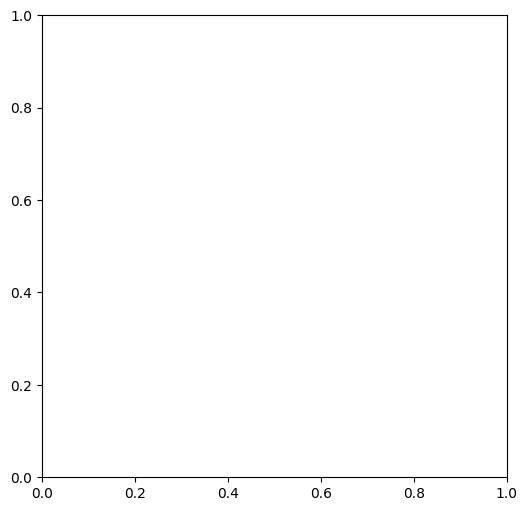

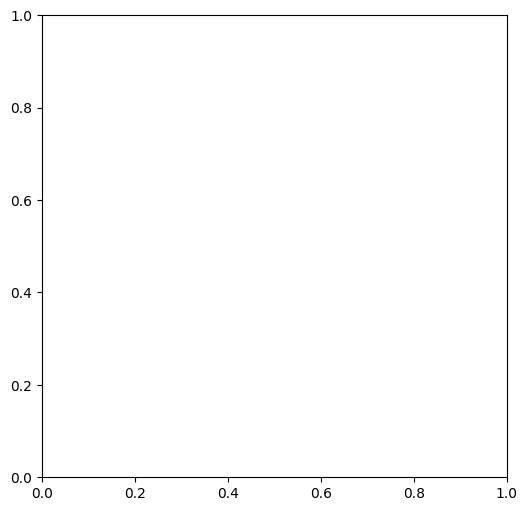

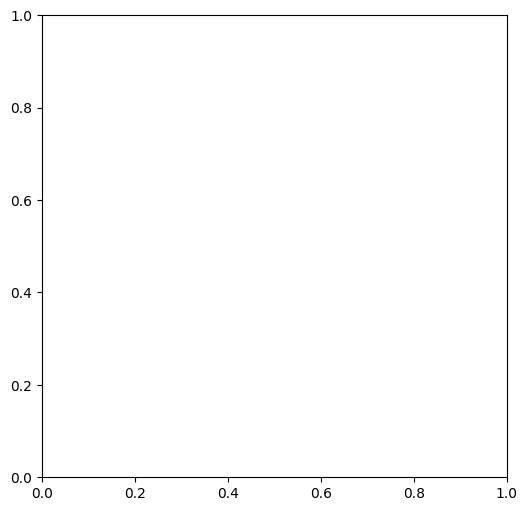

...

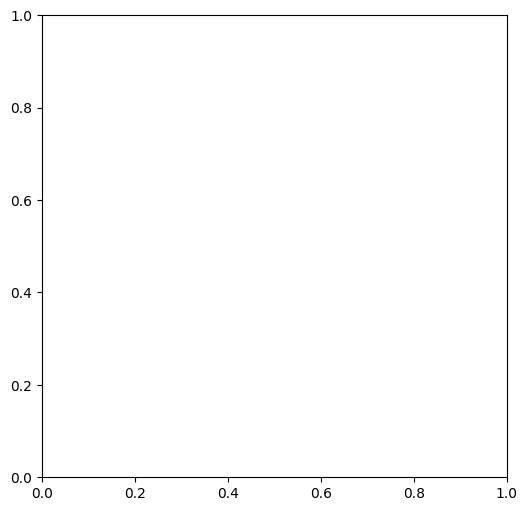

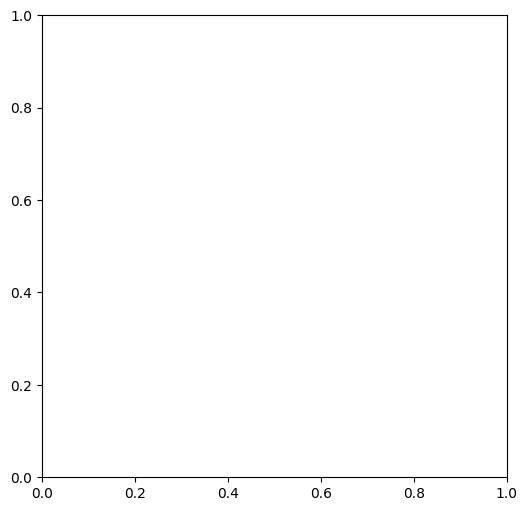

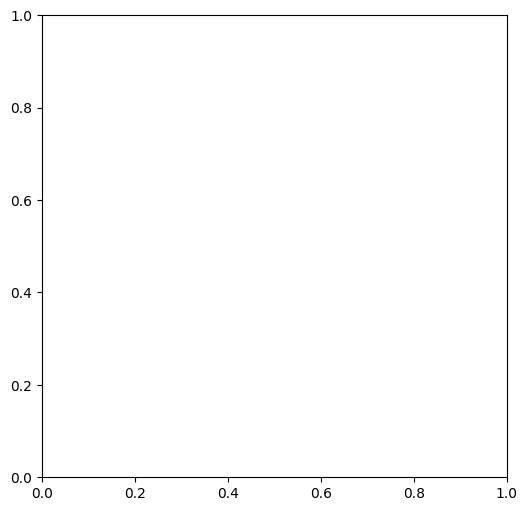

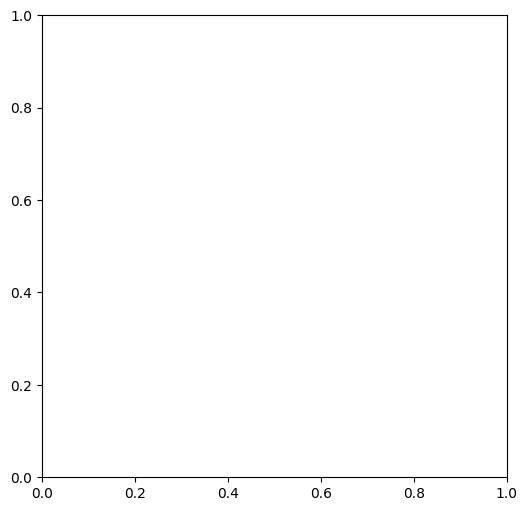

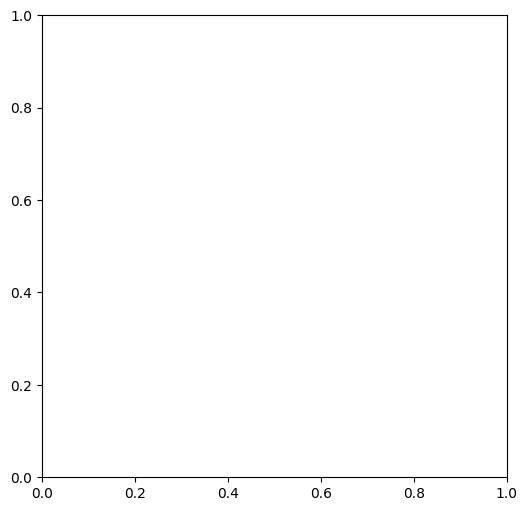

In [ ]:
stop=1                                      #### testing cell
Kelp_files_list=[]
files_with_zero_class = []
C_with_All_zeroes =[]
from matplotlib.colors import ListedColormap
for i in test_files:                           ###### Apply this on ALL FILES IN NEW MODEL
    with rasterio.open(test_data_path  + i) as src:
        #show(src,cmap='terrain')
        GREEN=src.read(4)    #### Only one out of 7 bands NOT labelled Data
        NIR = src.read(2)
        RED = src.read(3)
        SWIR = src.read(1)
        BLUE = src.read(5)
        CLOUD = src.read(6)

        mask_green = masking(GREEN,CLOUD)    ############3 masking all bands with Clouds
        mask_nir = masking(NIR,CLOUD)
        mask_red = masking(RED,CLOUD)
        mask_swir = masking(SWIR,CLOUD)
        mask_blue = masking(BLUE,CLOUD)

        df = pd.DataFrame()
        df['mask_swir'] = mask_swir.flatten().tolist()
        df['mask_nir']  = mask_nir.flatten().tolist()
        df['mask_red']  = mask_red.flatten().tolist()
        df['mask_green'] = mask_green.flatten().tolist()
        df['mask_blue']  = mask_blue.flatten().tolist()




        NDVI   = (es.normalized_diff(mask_nir,mask_red))
        CVI = (es.normalized_diff(mask_nir,mask_green))
        #show(NDVI,cmap='Greens')

        # Create classes and apply to NDVI results
        ndvi_class_bins = [0.01,0.35]    ##### LESS VEGETATION FOR KELP
        ndvi_landsat_class = np.digitize(NDVI, ndvi_class_bins)      #### https://www.geeksforgeeks.org/python-numpy-np-digitize-method/

        # Apply the nodata mask to the newly classified NDVI data
        ndvi_landsat_class = np.ma.masked_where(
        np.ma.getmask(NDVI), ndvi_landsat_class)
        np.unique(ndvi_landsat_class)

        # Define color map
        nbr_colors = [ "y", "g"]
        nbr_cmap = ListedColormap(nbr_colors)

        # Define class names
        ndvi_cat_names = [

                    "Low Vegetation",

                    "High Vegetation",
                        ]

        # Get list of classes
        classes = np.unique(ndvi_landsat_class)
        classes = classes.tolist()
          # The mask returns a value of none in the classes. remove that
        classes = classes[0:2]
        if(len(classes) < 2):
          print("no kelp")
          files_with_zero_class.append(i)
          break


        # Plot your data
        fig, ax = plt.subplots(figsize=(6, 6))
        #im = ax.imshow(ndvi_landsat_class, cmap=nbr_cmap)

        #ep.draw_legend(im_ax=im, classes=classes, titles=ndvi_cat_names)
        #ax.set_title(
                     # "Landsat 8 - Filtered at 0.5 Normalized Difference Vegetation Index (NDVI) Classes",fontsize=14,)
        #ax.set_axis_off()

        # Auto adjust subplot to fit figure size
        #plt.tight_layout()
        #plt.show()


        MIR=1
        KT = (0.1509*mask_blue+ .1793*mask_green+0.3279* mask_red +0.3406*mask_nir+0.7112*MIR +0.4572*mask_swir)       #### For Water positive values mark water
        MNDWI= (es.normalized_diff(mask_green,mask_swir))    ### For Water
        NDWI = (es.normalized_diff(mask_red,mask_swir))    #### for Water

# Create classes and apply to MNDWI results
        mndwi_class_bins = [0.01,0.35]    #####ALL Water  FOR KELP
        mndwi_landsat_class = np.digitize(MNDWI, mndwi_class_bins)      #### https://www.geeksforgeeks.org/python-numpy-np-digitize-method/

        # Apply the nodata mask to the newly classified MNDWI data
        mndwi_landsat_class = np.ma.masked_where(
        np.ma.getmask(MNDWI), mndwi_landsat_class)
        np.unique(mndwi_landsat_class)

        # Define color map
        nbr_colors = [ "y", "b"]
        nbr_cmap = ListedColormap(nbr_colors)

        # Define class names
        mndwi_cat_names = [

                    "Less Water",

                    "More Water",
                        ]

        # Get list of classes
        classes = np.unique(mndwi_landsat_class)
        classes = classes.tolist()
          # The mask returns a value of none in the classes. remove that
        classes = classes[0:2]
        if(len(classes) < 2):
          print("no kelp")
          files_with_zero_class.append(i)
          break

        # Plot your data
        fig, ax = plt.subplots(figsize=(6, 6))
        #im = ax.imshow(mndwi_landsat_class, cmap=nbr_cmap)

        #ep.draw_legend(im_ax=im, classes=classes, titles=mndwi_cat_names)
        #ax.set_title(
                 #     "Landsat 8 - Filtered at 0.45 MNDWI Classes",fontsize=14,)
        #ax.set_axis_off()

        # Auto adjust subplot to fit figure size
        #plt.tight_layout()
        #plt.show()

        A = (mndwi_landsat_class)   #### More water
        B = (ndvi_landsat_class)      ##### less vegetation

        A = masking(A,CLOUD)  ### making sure Cloud mask is applied to output kelp
        B=masking(B,CLOUD)

        C = np.logical_and(A, B)

              ######     this C is kelp


        ##### MASK C with cloud....!!!!
        #C_mask = masking(C,CLOUD)
        #show(C,cmap='Greens')

        if C.all == False:
          print("not kelp")
          C_with_All_zeroes.append(C)



        else:
          x = 1 *C
          x[x!=0]=1
          x.mask = False   #### remove mask values inherited from C after masking
          import numpy.ma as ma
          #X = ma.getdata(x)
          #Y = ma.getmaskarray(x)

          #Y_complement = np.logical_not(Y)   #### toremove masked CLOUD pixels from output.....
          #X_output = np.logical_and(X,Y_complement)

          #X_output = 1*X_output  ### convert True to 1 and False to 0

          #array = X_output

          Z = masking(x,CLOUD)
          Z= Z.astype(int)
          array = Z
          #array = x
          #show(array,cmap='Greens')
          #print("kelp")


          # Write an array as a raster band to a new 8-bit file. For
          # the new file's profile, we start with the profile of the source
          # context manager.
          with rasterio.Env():

    # Write an array as a raster band to a new 8-bit file. For
    # the new file's profile, we start with the profile of the source
            profile = src.profile

    # And then change the band count to 1, set the
    # dtype to uint8, and specify LZW compression.
            profile.update(
            dtype=rasterio.uint8,
            count=1,
            compress='lzw')

            with rasterio.open('/content/drive/MyDrive/MAA/'+i, 'w', **profile) as dst:
              dst.write(array.astype(rasterio.uint8), 1)


          Kelp_files_list.append(i)



In [ ]:
Z


masked_array(
  data=[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],
  mask=[[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]],
  fill_value=999999)

In [ ]:
Z.min()

0

In [ ]:
Z.max()

1

In [ ]:
df2 = pd.DataFrame()
df2['data'] = Z.flatten().tolist()
df2['mask'] = CLOUD.flatten().tolist()
df2

,data,mask
0,0.0,0
1,0.0,0
2,0.0,0
3,0.0,0
4,0.0,0
...,...,...
122495,0.0,0
122496,0.0,0
122497,0.0,0
122498,0.0,0


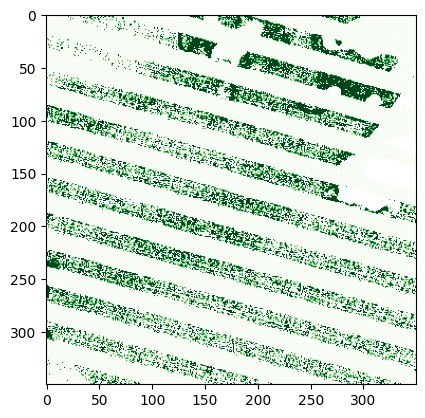

<Axes: >

In [ ]:
show(Z,cmap='Greens')

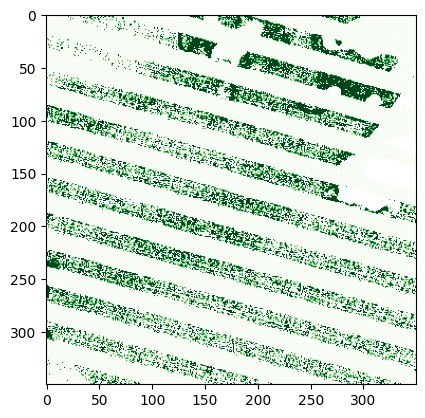

<Axes: >

In [ ]:
show(masking(x,CLOUD),cmap='Greens')

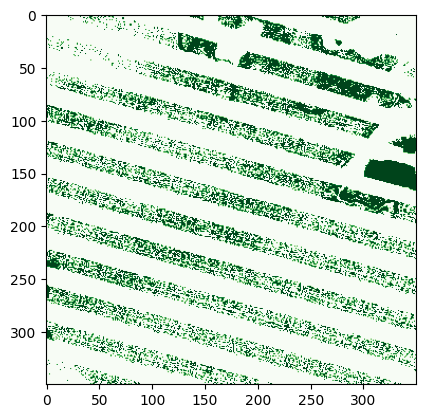

<Axes: >

In [ ]:
show(ma.getdata(x),cmap='Greens')

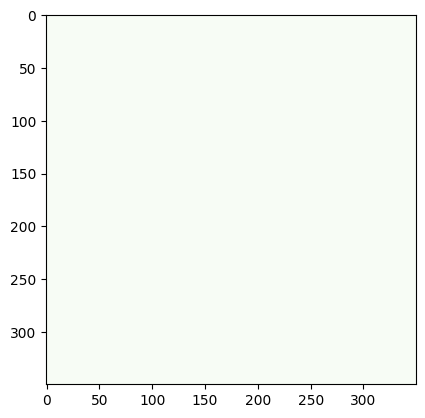

<Axes: >

In [ ]:
show(ma.getmaskarray(x),cmap='Greens')

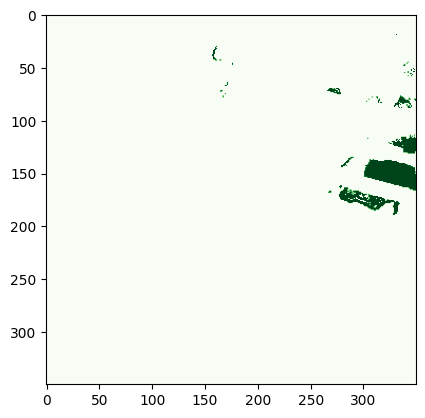

<Axes: >

In [ ]:
show(CLOUD,cmap='Greens')

In [ ]:
X= masking(x,CLOUD)

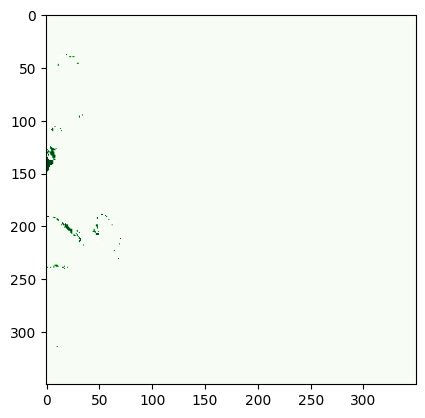

<Axes: >

In [ ]:
show(X,cmap='Greens')

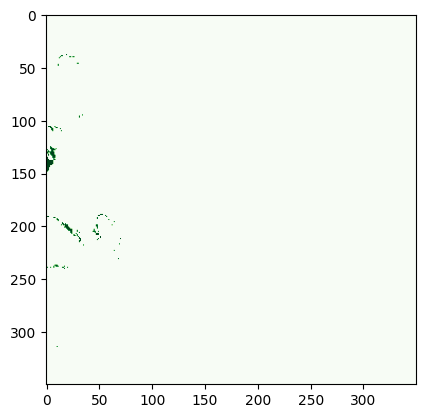

<Axes: >

In [ ]:
show(x,cmap= 'Greens')

In [ ]:
if x.all()==X.all():
  print("same")
else:
  print("not same")

same


In [ ]:
for i in os.listdir('/content/drive/MyDrive/MAA'):
  s = i.split('_')
  ss = s[0] + '_kelp.tif'
  os.rename('/content/drive/MyDrive/MAA/'+i,'/content/drive/MyDrive/MAA/'+ss)

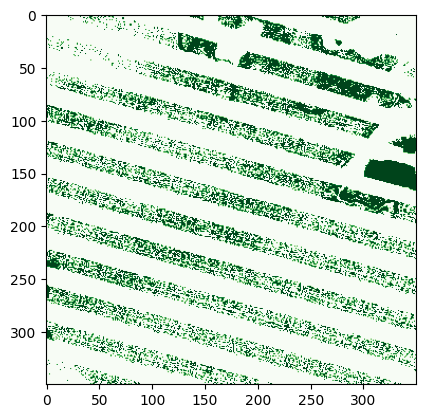

In [ ]:
with rasterio.open('/content/sample_data/HP480632_satellite.tif') as src:
    show(src.read(),cmap='Greens')

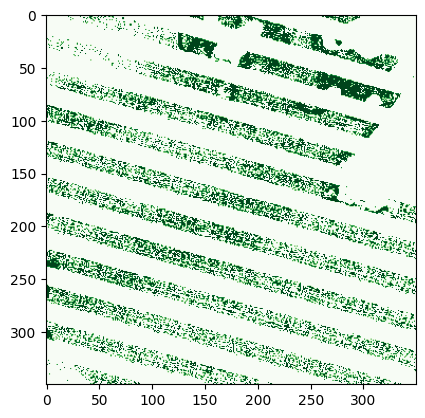

In [ ]:
with rasterio.open('/content/sample_data/HP480632_satellite.tif') as src:
    show(src.read(),cmap='Greens')

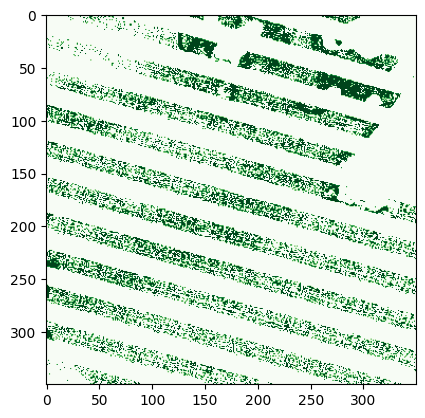

[[[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]]
1


In [ ]:
with rasterio.open('/content/sample_data/HP480632_satellite.tif') as src:
    show(src.read(),cmap='Greens')
    a = src.read()
    print(a)
    print(a.max())

In [ ]:
x

masked_array(
  data=[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],
  mask=[[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]],
  fill_value=999999)

In [ ]:
x.mask = False
x

masked_array(
  data=[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],
  mask=[[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]],
  fill_value=999999)

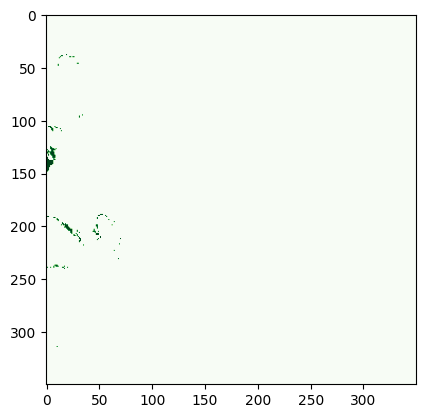

<Axes: >

In [ ]:
show(x,cmap='Greens')

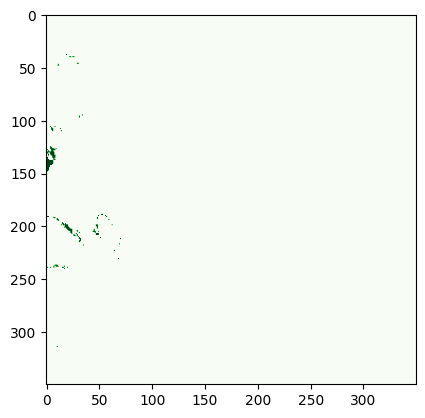

<Axes: >

In [ ]:
show(array,cmap='Greens')

In [ ]:
x.max()

1

In [ ]:
X_output.max()

True

In [ ]:
X_output = 1*X_output

In [ ]:
X_output.max()

1

In [ ]:
X_output.min()

0

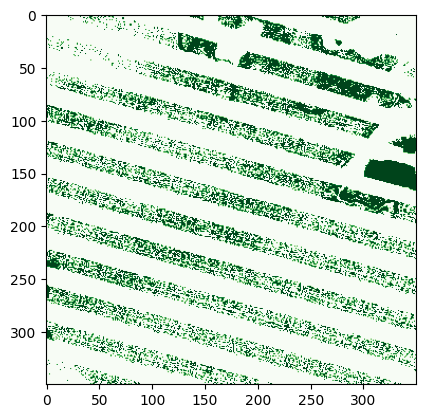

<Axes: >

In [ ]:
show(X,cmap='Greens')

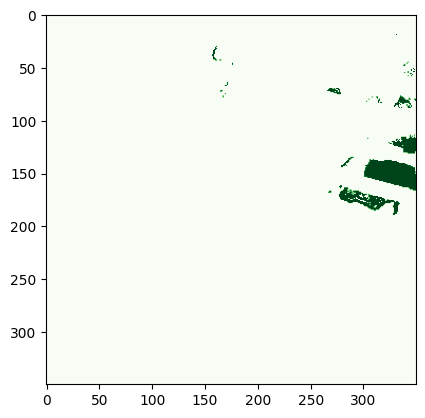

<Axes: >

In [ ]:
show(Y,cmap='Greens')

In [ ]:
Y_complement = np.logical_not(Y)

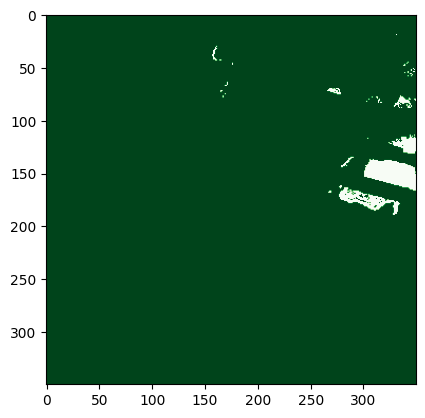

<Axes: >

In [ ]:
show( Y_complement,cmap='Greens')

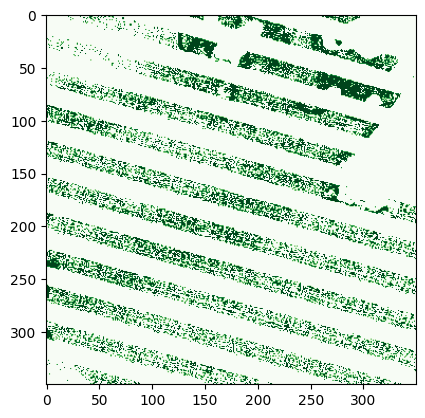

<Axes: >

In [ ]:
output = np.logical_and(X, Y_complement)
show(output,cmap='Greens')

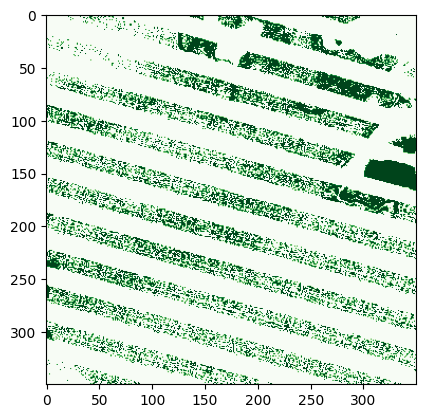

<Axes: >

In [ ]:
show(X,cmap='Greens')

In [ ]:
df1 = pd.DataFrame()
df1['data'] = X.flatten().tolist()
Y=1*Y
df1['mask'] = Y.flatten().tolist()
df1

,data,mask
0,0,0
1,0,0
2,0,0
3,0,0
4,0,0
...,...,...
122495,0,0
122496,0,0
122497,0,0
122498,0,0


/usr/local/lib/python3.10/dist-packages/numpy/lib/function_base.py:4691: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  arr.partition(
/usr/local/lib/python3.10/dist-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


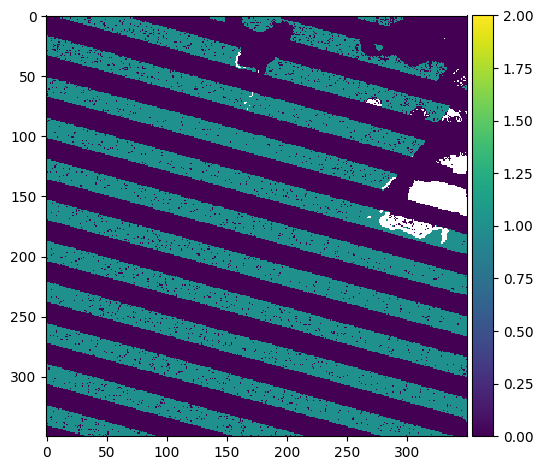

In [ ]:
from skimage.io import imread, imshow
imshow(mndwi_landsat_class,vmin=0,vmax=2)

In [ ]:
#### using k means

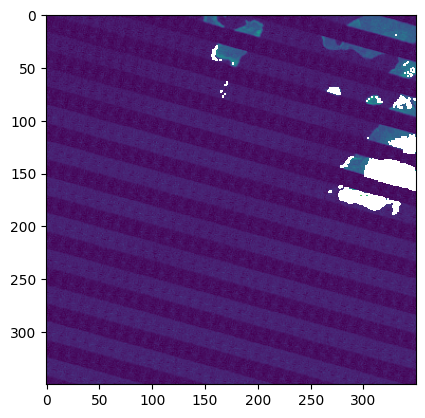

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


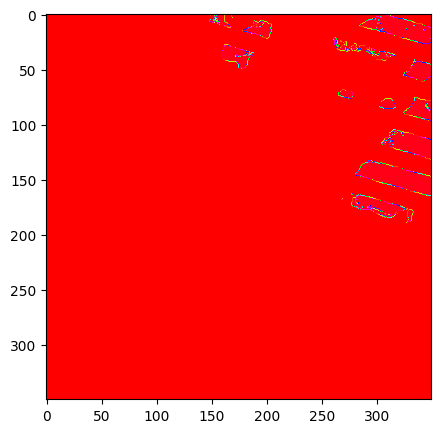

1
0


/usr/local/lib/python3.10/dist-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


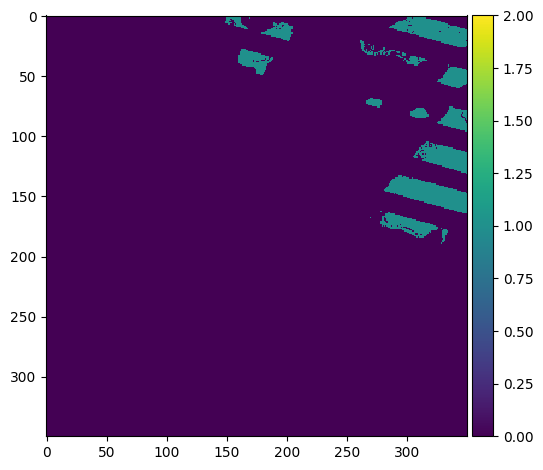

In [ ]:
import numpy as np
from sklearn import cluster
data_array = mask_swir

show(data_array)
X = data_array.reshape((-1,1))
k_means = cluster.KMeans(n_clusters=2)
k_means.fit(X)
X_cluster = k_means.labels_
X_cluster = X_cluster.reshape(data_array.shape)
plt.figure(figsize=(5,5))
plt.imshow(X_cluster, cmap="hsv")
plt.show()
print(X_cluster.max())
print(X_cluster.min())
imshow(X_cluster,vmin=0,vmax=2)




In [ ]:
X_cluster

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)

In [ ]:
DF = pd.DataFrame()
DF['RED']=RED.flatten().tolist()
DF['NIR']=NIR.flatten().tolist()
DF['SWIR']=SWIR.flatten().tolist()
DF['BLUE']=BLUE.flatten().tolist()
DF['GREEN']=GREEN.flatten().tolist()
DF['CLOUD'] = CLOUD.flatten().tolist()

In [ ]:
DF.describe()

,RED,NIR,SWIR,BLUE,GREEN,CLOUD
count,122500.000000,122500.000000,122500.000000,122500.000000,122500.000000,122500.000000
mean,7165.134220,7708.146041,7648.424653,5782.867853,6781.154531,0.016196
std,1195.302631,1271.626646,883.474917,3013.933907,1790.386272,0.126229
min,5798.000000,6389.000000,6828.000000,2216.000000,4541.000000,0.000000
25%,6068.000000,6884.000000,7223.000000,2749.000000,5037.000000,0.000000
50%,7407.000000,7494.000000,7432.000000,6952.000000,7115.000000,0.000000
75%,7946.000000,8103.000000,7846.000000,8657.000000,8482.000000,0.000000
max,27209.000000,25280.000000,17162.000000,27338.000000,29102.000000,1.000000


In [ ]:
DF


,RED,NIR,SWIR,BLUE,GREEN,CLOUD
0,6067,7188,7639,3458,5383,0
1,6335,7188,7430,4338,5383,0
2,6603,7188,7223,5038,6076,0
3,7139,7493,7639,5734,6422,0
4,7406,7493,7430,6772,7111,0
...,...,...,...,...,...,...
122495,6068,6884,7223,2751,5384,0
122496,6068,6884,7223,2929,5384,0
122497,6068,6884,7223,3106,5037,0
122498,6068,6884,6828,2929,5037,0


In [ ]:
DF['CLOUD'][DF['CLOUD']==1].count()      #### 1984 cloud pixels that are masked off bands....

1984

In [ ]:
df

,mask_swir,mask_nir,mask_red,mask_green,mask_blue,KT
0,7639.0,7188.0,6067.0,5383.0,3458.0,9417.8482
1,7430.0,7188.0,6335.0,5383.0,4338.0,9542.9626
2,7223.0,7188.0,6603.0,6076.0,5038.0,9766.0843
3,7639.0,7493.0,7139.0,6422.0,5734.0,10402.9811
4,7430.0,7493.0,7406.0,7111.0,6772.0,10675.1475
...,...,...,...,...,...,...
122495,7223.0,6884.0,6068.0,5384.0,2751.0,9017.9315
122496,7223.0,6884.0,6068.0,5384.0,2929.0,9044.7917
122497,7223.0,6884.0,6068.0,5037.0,3106.0,9009.2839
122498,6828.0,6884.0,6068.0,5037.0,2929.0,8801.9806


In [ ]:
df.describe()

,mask_swir,mask_nir,mask_red,mask_green,mask_blue,KT
count,120516.000000,120516.000000,120516.000000,120516.000000,120516.000000,120516.000000
mean,7572.525374,7606.001046,7104.322795,6715.309469,5715.514786,10449.507371
std,570.496287,913.102788,1015.068562,1651.932618,2943.526887,1505.951075
min,6828.000000,6389.000000,5798.000000,4541.000000,2216.000000,8429.402300
25%,7223.000000,6884.000000,6068.000000,5037.000000,2749.000000,8955.865300
50%,7432.000000,7493.000000,7404.000000,7107.000000,6594.000000,10693.053050
75%,7846.000000,8103.000000,7944.000000,8481.000000,8655.000000,11770.769000
max,17162.000000,17784.000000,13236.000000,14890.000000,23153.000000,19459.850200


In [ ]:
df.isnull().sum()

mask_swir     1984
mask_nir      1984
mask_red      1984
mask_green    1984
mask_blue     1984
KT            1984
dtype: int64

In [ ]:
####### remove negative reflectance if any

In [ ]:
df['mask_red'][df['mask_red']<0]=np.nan
df['mask_nir'][df['mask_nir']<0]=np.nan
df['mask_swir'][df['mask_swir']<0]=np.nan
df['mask_blue'][df['mask_blue']<0]=np.nan
df['mask_green'][df['mask_green']<0]=np.nan

In [ ]:
df.isna().sum()

mask_swir     1984
mask_nir      1984
mask_red      1984
mask_green    1984
mask_blue     1984
KT            1984
dtype: int64

In [ ]:
MIR=1
KT = (0.1509*mask_blue+ .1793*mask_green+0.3279* mask_red +0.3406*mask_nir+0.7112*MIR +0.4572*mask_swir)
df['KT'] = KT.flatten().tolist()

In [ ]:
x = df['mask_swir']
y = df['mask_nir']
z = df['mask_red']

                                          mask_swir


<Axes: >

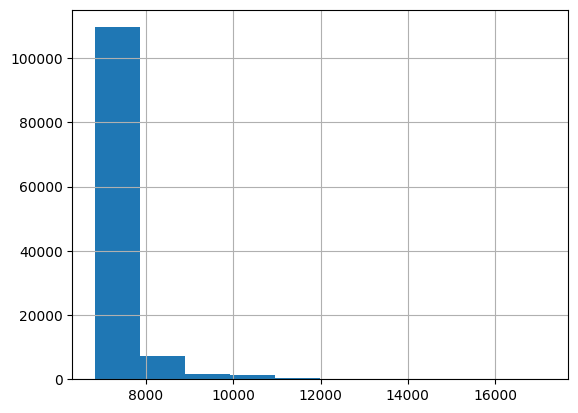

In [ ]:
print('                                          mask_swir')
x.hist()

                                              mask Nir


<Axes: >

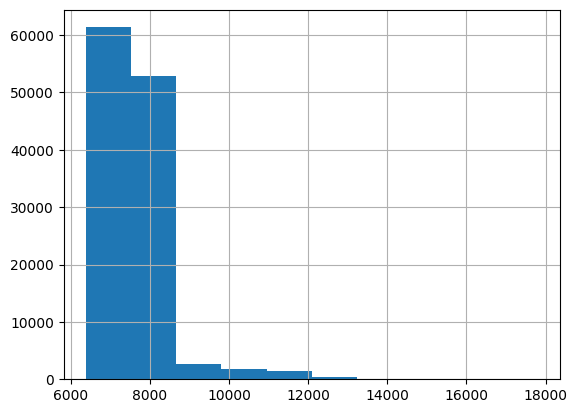

In [ ]:
print('                                              mask Nir')
y.hist()

                                                mask red


<Axes: >

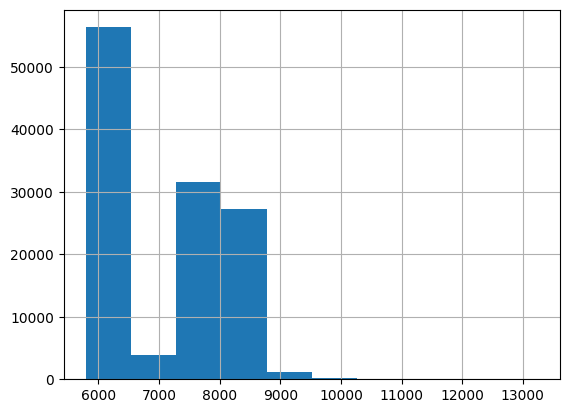

In [ ]:
print('                                                mask red')
z.hist()

In [ ]:
df['mask_swir'].describe()

count    120516.000000
mean       7572.525374
std         570.496287
min        6828.000000
25%        7223.000000
50%        7432.000000
75%        7846.000000
max       17162.000000
Name: mask_swir, dtype: float64

In [ ]:
###################   using CNN.....

In [ ]:
train_kelp_path = '/content/drive/MyDrive/train_kelp'
train_satellite_path = '/content/drive/MyDrive/train_satellite'

In [ ]:
import os
train_kelp_files = os.listdir(train_kelp_path)
train_satellite_files = os.listdir(train_satellite_path)


In [ ]:
import pandas as pd
df_train = pd.DataFrame()
df_train['kelp'] = train_kelp_files
#df_train['satellite'] = train_satellite_files

In [ ]:
df_train

,kelp
0,WS515055_kelp.tif
1,IR542693_kelp.tif
2,CK456814_kelp.tif
3,RO426752_kelp.tif
4,MS427523_kelp.tif
...,...
5631,OP339220_kelp.tif
5632,HC457137_kelp.tif
5633,KM892313_kelp.tif
5634,MN294760_kelp.tif


In [ ]:
pip install rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 47.1 MB/s eta 0:00:00


In [ ]:
import rasterio
from rasterio.plot import show

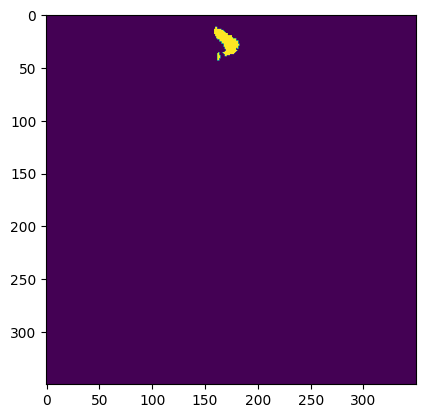

In [ ]:
with rasterio.open('/content/drive/MyDrive/train_kelp/AA498489_kelp.tif') as src:    #### from TRAIN_mask
    show(src.read(1))
    y_data = src.read(1)

In [ ]:
y_data.min()

0

In [ ]:
y_data.max()

1

/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


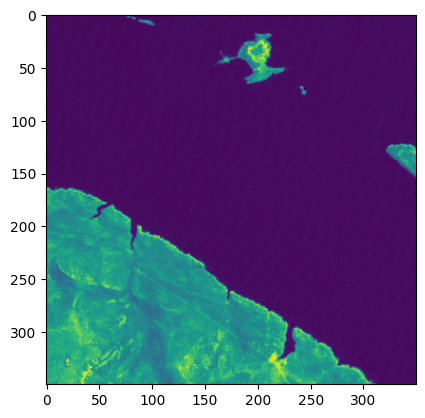

In [ ]:
with rasterio.open('/content/drive/MyDrive/train_satellite/AA498489_satellite.tif') as src:    #### from TRAIN_X
    show(src.read(1))
    x_data = src.read(1)
    cloud = src.read(6)

In [ ]:
###### let us try to loacte kelp in satellite unlabelled data.....
####    and replace kelp with Zeroes.... and cloud with -999

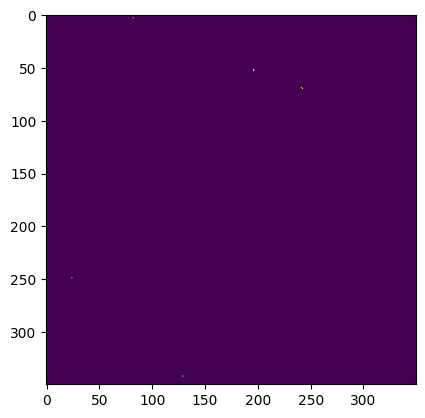

<Axes: >

In [ ]:
show(cloud)

In [ ]:
X = x_data.astype(np.float32)
Y = y_data
for i in range(x_data.shape[0]):
    for j in range(x_data.shape[1]):
        if Y[i][j] == 1:
            X[i][j] = 0

In [ ]:
cloud

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)

In [ ]:
for i in range(x_data.shape[0]):
    for j in range(x_data.shape[1]):
        if cloud[i][j] == 1:
            X[i][j] = -999            #### for cloud mask

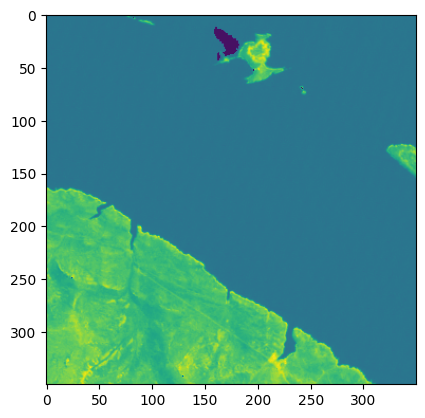

<Axes: >

In [ ]:
show(X)

In [ ]:
list_common= []
list_not_common=[]

In [3]:
train_kelp_path = '/content/drive/MyDrive/train_kelp'
train_satellite_path = '/content/drive/MyDrive/train_satellite'

In [10]:
import os

In [11]:
train_kelp_list = os.listdir(train_kelp_path)
train_satellite_list = os.listdir(train_satellite_path)


In [12]:
len(train_kelp_list)

5636

In [13]:
train_kelp_list[0]

'WS515055_kelp.tif'

In [14]:
train_satellite_list[0]

'RT943858_satellite.tif'

In [15]:
len(train_satellite_list)

5635

In [16]:
len(train_kelp_list)

5636

In [17]:
for i in train_satellite_list:
  s = i.split('_')
  ss = s[0] + '_kelp.tif'
  if ss not in train_kelp_list:
    print(ss)


In [19]:
pip install rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 46.4 MB/s eta 0:00:00


In [21]:
import rasterio
from rasterio.plot import show

/usr/local/lib/python3.10/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


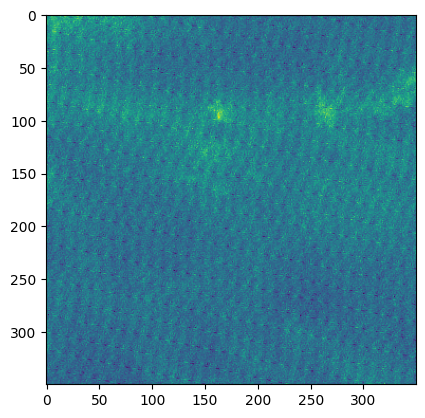

7
{'driver': 'GTiff', 'dtype': 'int32', 'nodata': None, 'width': 350, 'height': 350, 'count': 7, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0)}


In [22]:
with rasterio.open('/content/drive/MyDrive/train_satellite/VE466813_satellite.tif') as src:    #### from TRAIN_mask
    show(src.read(1))
    print(src.count)
    print(src.meta)

In [96]:
X = []
Y = []
y = []
kelp=[]
not_kelp=[]
training_images_list = []
stop=0
for i in train_satellite_list:     ##### to mask each band with kelp data
  with rasterio.open(train_satellite_path+'/'+i) as src:    #### from TRAIN_X
    for j in range(1,6):    #### first 5 bands....swir,nir,red,green,blue
      x_data = src.read(j)

      training_images_list.append(i)
      s = i.split('_')
      ss = s[0] + '_kelp.tif'
      if ss in train_kelp_list:
        with rasterio.open(train_kelp_path+'/'+ss) as SRC:    #### from TRAIN_mask
          y_data = SRC.read(1)
          Y.append(y_data)
          check =0

          for k in range(y_data.shape[0]):
            for l in range(y_data.shape[1]):
              if y_data[k][l] != 0:              ### all kelp data array y_data must be zeo for not kelp...
                check =1

          if check == 1:
            y.append(1)
            kelp.append(i)
          else:
            y.append(0)
            not_kelp.append(i)


          for k in range(x_data.shape[0]):
            for l in range(x_data.shape[1]):
              if y_data[k][l] == 1:
                x_data[k][l] = 0                     ### replace reflectance of each band with 0 for kelp pixels in y_data=1

      for k in range(x_data.shape[0]):
        for l in range(x_data.shape[1]):
          if cloud[k][l] == 1:
            x_data[k][l] = -999                   ####  mask cloud areas with -999
      X.append(x_data)
    stop = stop+1
    if stop ==1000:
        break

In [97]:
len(X)


5000

In [98]:
len(Y)

5000

In [99]:
len(y)

5000

In [100]:
X[0]

array([[10747, 13286, 15318, ..., 14931, 14590, 14410],
       [ 8525,  9083, 11046, ..., 14826, 14587, 14353],
       [ 7881,  8430,  8395, ..., 14809, 14547, 14228],
       ...,
       [ 7633,  7640,  7684, ...,  -999,  -999,  -999],
       [ 7668,  7682,  7712, ...,  -999,  -999,  -999],
       [ 7677,  7718,  7692, ...,  -999,  -999,  -999]], dtype=int32)

In [101]:
Y[0]

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int8)

In [102]:
len(Y)

5000

In [103]:
len(y)

5000

In [104]:
import numpy as np

In [105]:
y_array = np.array(y)

In [106]:
y_array.shape

(5000,)

In [107]:
y_array[0:10]

array([1, 1, 1, 1, 1, 0, 0, 0, 0, 0])

In [121]:
X_array = X

In [122]:
X_array = np.array(X)

In [123]:
X_array.shape

(5000, 350, 350)

In [124]:
from sklearn.preprocessing import StandardScaler   ### z score normalization

In [125]:
scaler = StandardScaler()

In [126]:
for i in range(X_array.shape[0]):
  X_array[i] = scaler.fit_transform(X_array[i])   ### Normalizing X_array

In [127]:
X_array = X_array.reshape(X_array.shape[0],350,350,1)      #### input shape (5000,350,350,1)

In [128]:
X_array.shape

(5000, 350, 350, 1)

In [129]:
y_array = y_array.reshape(y_array.shape[0],1)              #### output shape (5000,1)

In [130]:
y_array.shape

(5000, 1)

In [131]:
kelp[0:10]

['RT943858_satellite.tif',
 'RT943858_satellite.tif',
 'RT943858_satellite.tif',
 'RT943858_satellite.tif',
 'RT943858_satellite.tif',
 'IR542693_satellite.tif',
 'IR542693_satellite.tif',
 'IR542693_satellite.tif',
 'IR542693_satellite.tif',
 'IR542693_satellite.tif']

In [132]:
len(kelp)

3270

In [133]:
len(not_kelp)

1730

In [134]:
X_array.shape[0]

5000

In [135]:
X_array[0]

array([[[14],
        [16],
        [16],
        ...,
        [ 1],
        [ 0],
        [ 0]],

       [[ 3],
        [ 4],
        [ 7],
        ...,
        [ 0],
        [ 0],
        [ 0]],

       [[ 0],
        [ 2],
        [ 1],
        ...,
        [ 0],
        [ 0],
        [ 0]],

       ...,

       [[ 0],
        [ 0],
        [ 0],
        ...,
        [-2],
        [-2],
        [-1]],

       [[ 0],
        [ 0],
        [ 0],
        ...,
        [-2],
        [-2],
        [-1]],

       [[ 0],
        [ 0],
        [ 0],
        ...,
        [-2],
        [-2],
        [-1]]], dtype=int32)

In [136]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K

In [137]:
model = keras.models.Sequential()

initializers = {

}

model.add(
    keras.layers.Conv2D(
        24, 5, input_shape=(350,350,1),
        activation='relu',
    )
)
model.add( keras.layers.MaxPooling2D(2) )
model.add(
    keras.layers.Conv2D(
        48, 5, activation='relu',
    )
)
model.add( keras.layers.MaxPooling2D(2) )
model.add(
    keras.layers.Conv2D(
        96, 5, activation='relu',
    )
)
model.add( keras.layers.Flatten() )
model.add( keras.layers.Dropout(0.2) )

model.add( keras.layers.Dense(
    1, activation='sigmoid',
    )
)

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 346, 346, 24)      624       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 173, 173, 24)     0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 169, 169, 48)      28848     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 84, 84, 48)       0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 80, 80, 96)        115296    
                                                                 
 flatten_2 (Flatten)         (None, 614400)           

In [138]:
from sklearn.model_selection import train_test_split
X = X_array
y = y_array

In [139]:
 X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=33)

In [140]:
import tensorflow.keras.optimizers as optimizers

optimizer = optimizers.Adam(learning_rate=0.001)

In [141]:
model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])

In [142]:
# Fit the model
model.fit(X, y, validation_split=0.33, epochs=1, batch_size=100)

34/34 [==============================] - 223s 7s/step - loss: 0.7981 - accuracy: 0.6205 - val_loss: 0.6264 - val_accuracy: 0.6638


In [143]:
eval = model.evaluate(X_test, y_test)

32/32 [==============================] - 7s 208ms/step - loss: 0.5388 - accuracy: 0.7590


In [144]:
prediction = model.predict(X_train)

125/125 [==============================] - 27s 213ms/step


In [145]:
prediction[0:2]

array([[0.722282  ],
       [0.61299545]], dtype=float32)

In [146]:
y_train[0:2]

array([[1],
       [1]])